2025-03-28 16:43:32.518006: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2 Pro
2025-03-28 16:43:32.518037: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2025-03-28 16:43:32.518043: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2025-03-28 16:43:32.518059: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-03-28 16:43:32.518072: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2025-03-28 16:43:38.577239: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


53/53 ━━━━━━━━━━━━━━━━━━━━ 41s 755ms/step
Detected 1 root systems in test_image_1.png


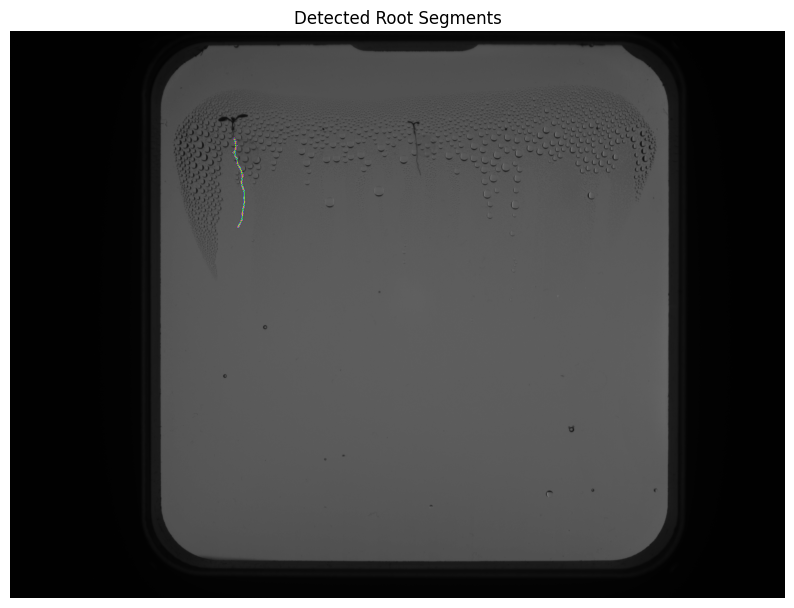

/var/folders/kz/slhyr0gd4qj4nrryyswvqv4c0000gn/T/ipykernel_29082/1878225294.py:102: VisibleDeprecationWarning: separator in column name will change to _ in version 0.13; to silence this warning, use `separator='-'` to maintain current behavior and use `separator='_'` to switch to the new default behavior.
  branches = summarize(skeleton_obj)


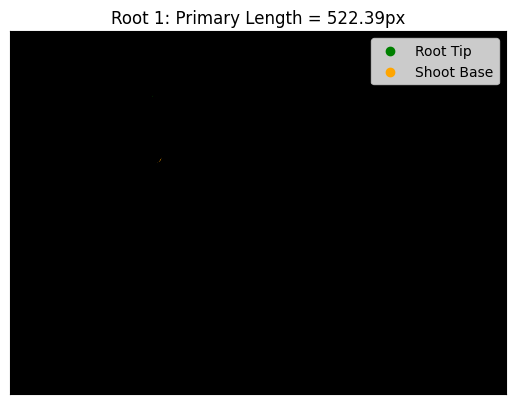

53/53 ━━━━━━━━━━━━━━━━━━━━ 35s 665ms/step
Detected 3 root systems in test_image_10.png


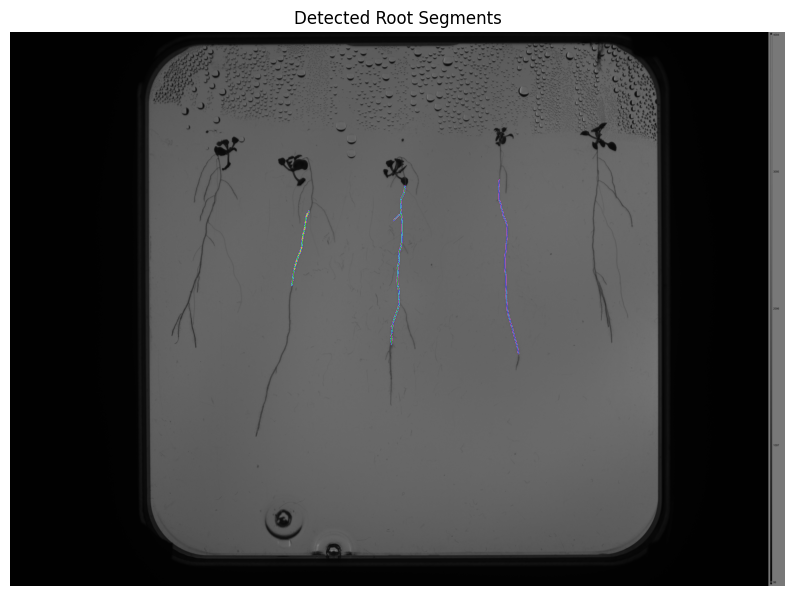

/var/folders/kz/slhyr0gd4qj4nrryyswvqv4c0000gn/T/ipykernel_29082/1878225294.py:102: VisibleDeprecationWarning: separator in column name will change to _ in version 0.13; to silence this warning, use `separator='-'` to maintain current behavior and use `separator='_'` to switch to the new default behavior.
  branches = summarize(skeleton_obj)


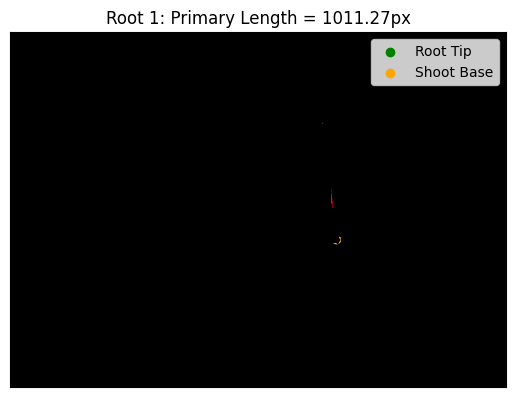

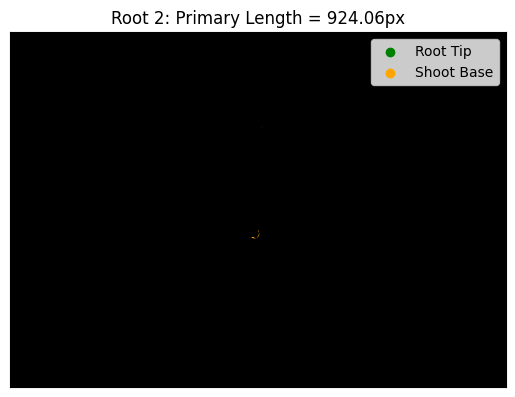

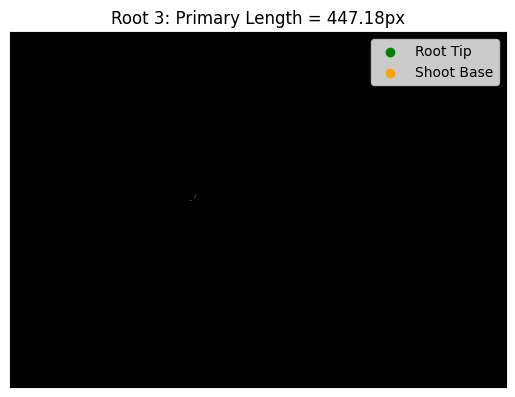

53/53 ━━━━━━━━━━━━━━━━━━━━ 38s 707ms/step
Detected 4 root systems in test_image_11.png


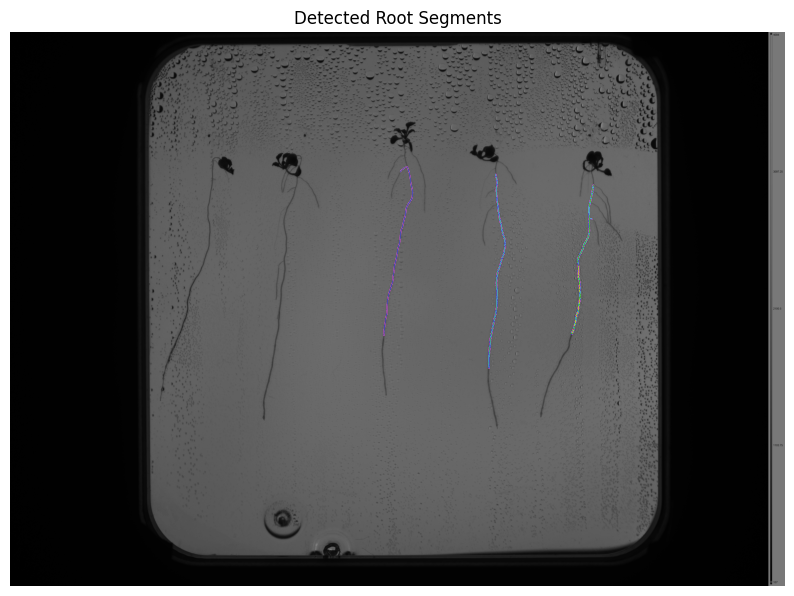

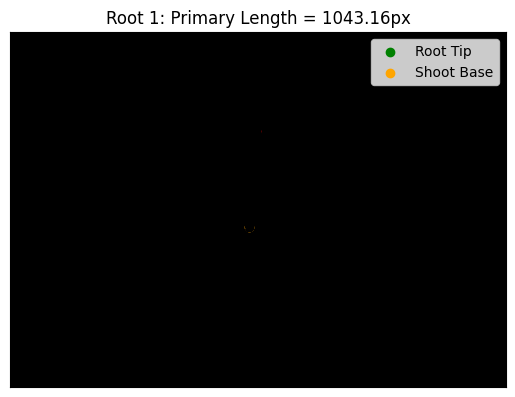

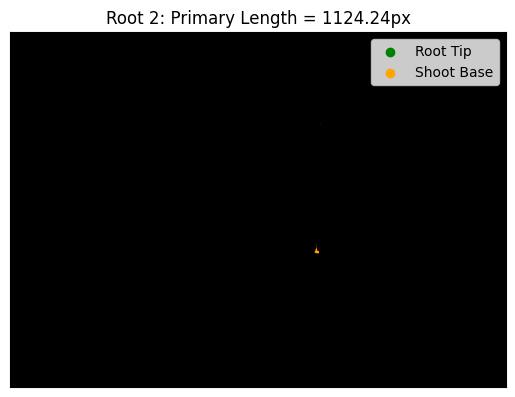

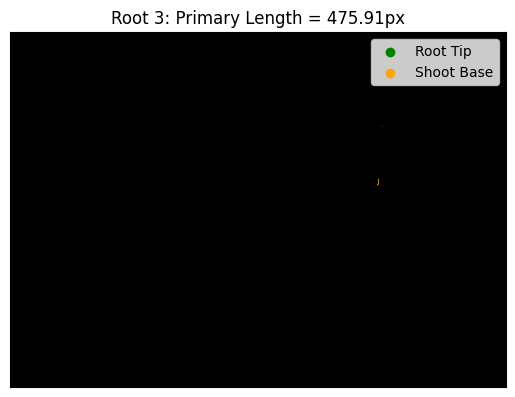

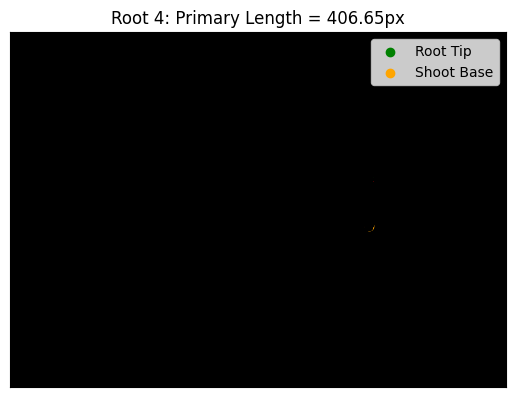

53/53 ━━━━━━━━━━━━━━━━━━━━ 35s 656ms/step
Detected 4 root systems in test_image_12.png


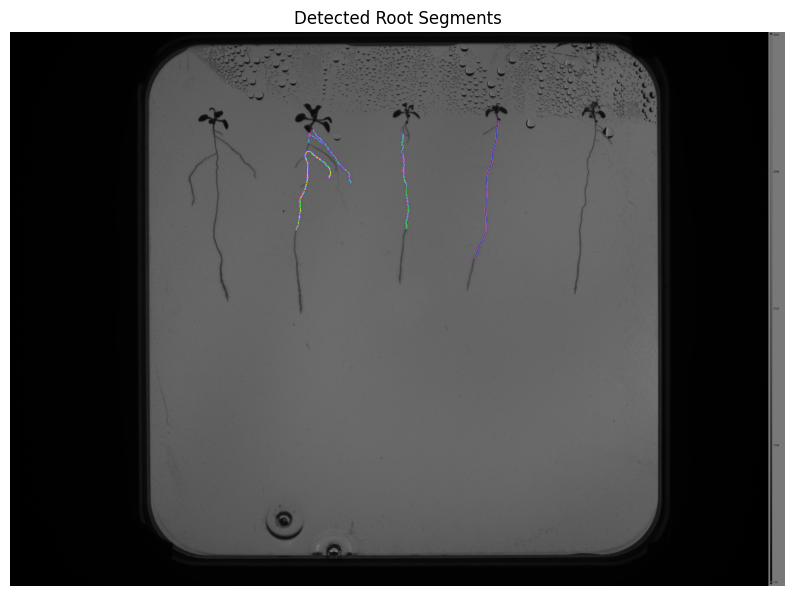

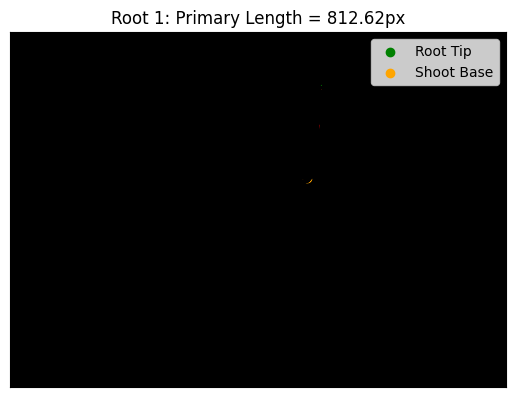

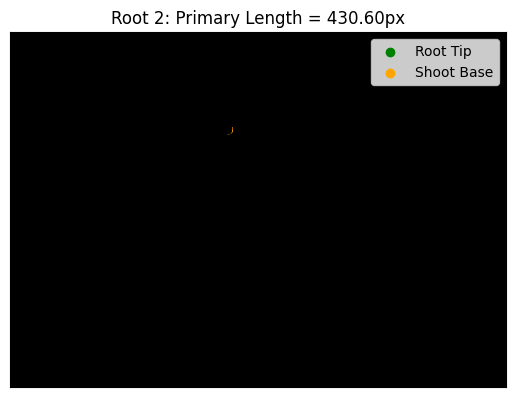

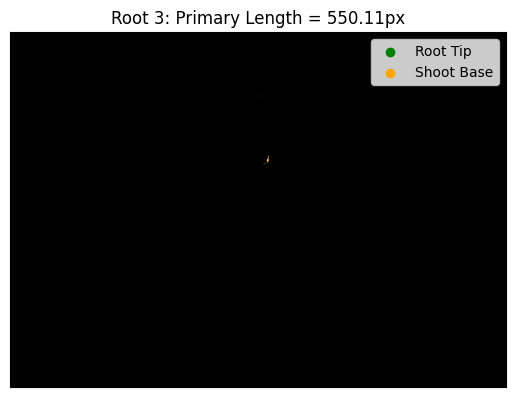

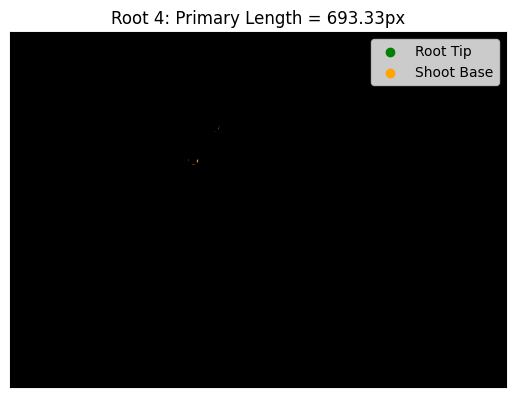

53/53 ━━━━━━━━━━━━━━━━━━━━ 36s 675ms/step
Detected 6 root systems in test_image_13.png


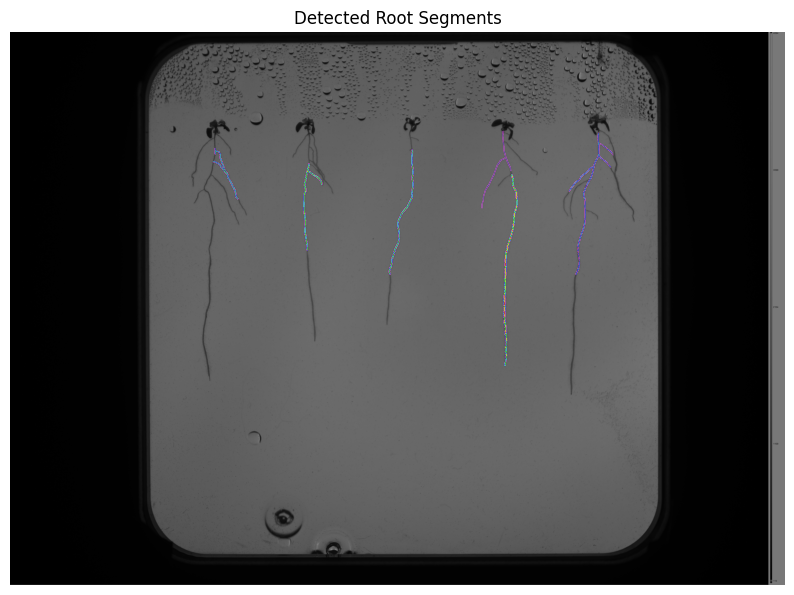

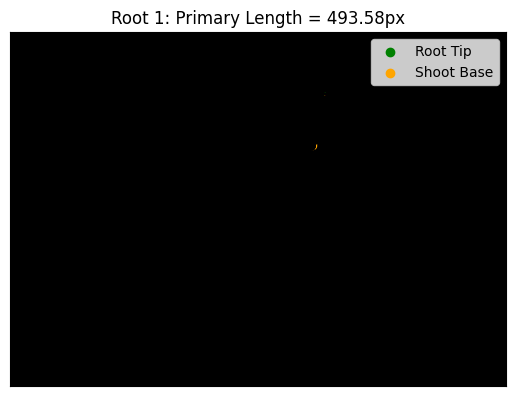

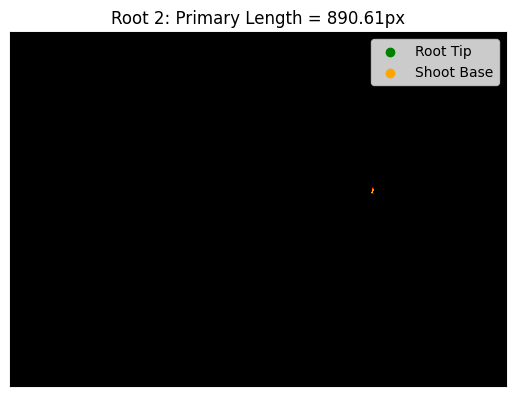

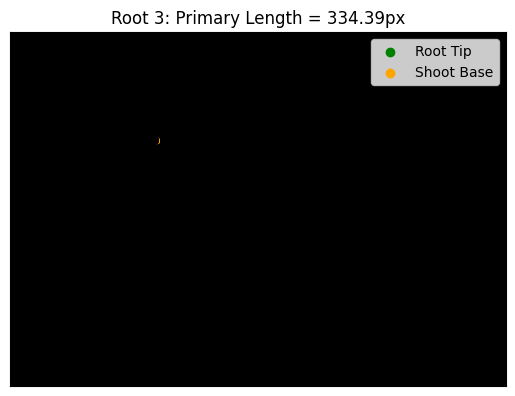

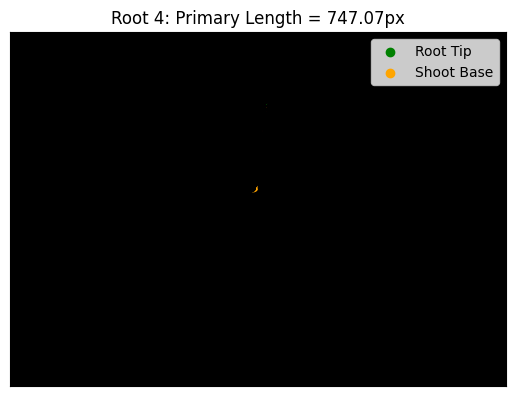

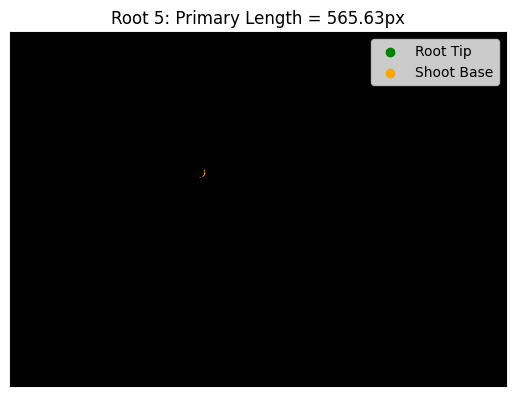

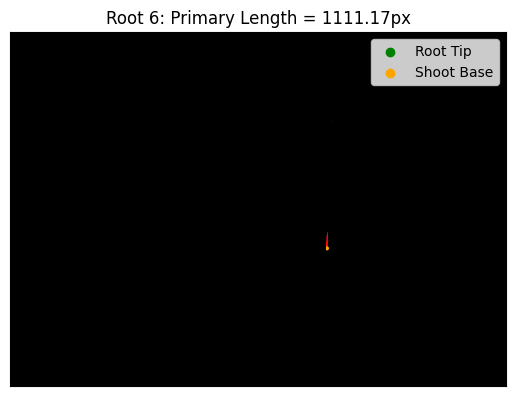

53/53 ━━━━━━━━━━━━━━━━━━━━ 36s 686ms/step
Detected 0 root systems in test_image_14.png


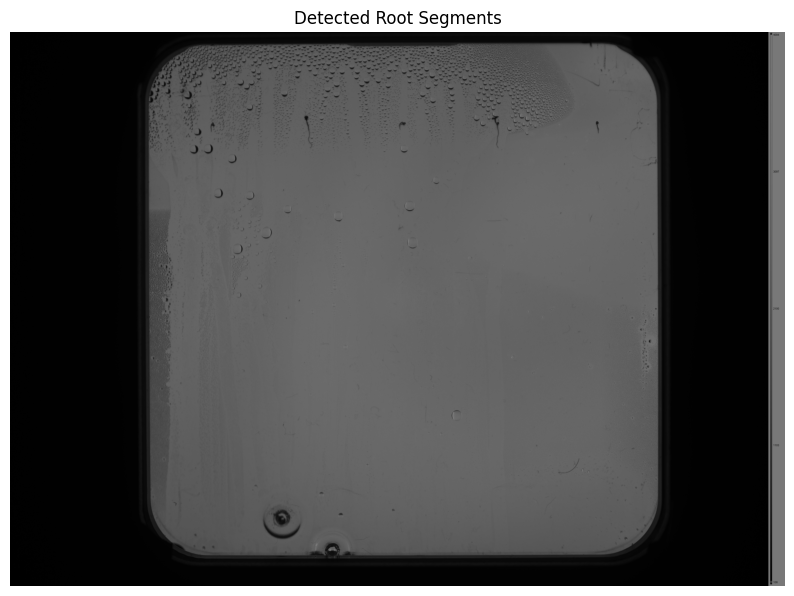

53/53 ━━━━━━━━━━━━━━━━━━━━ 43s 812ms/step
Detected 0 root systems in test_image_15.png


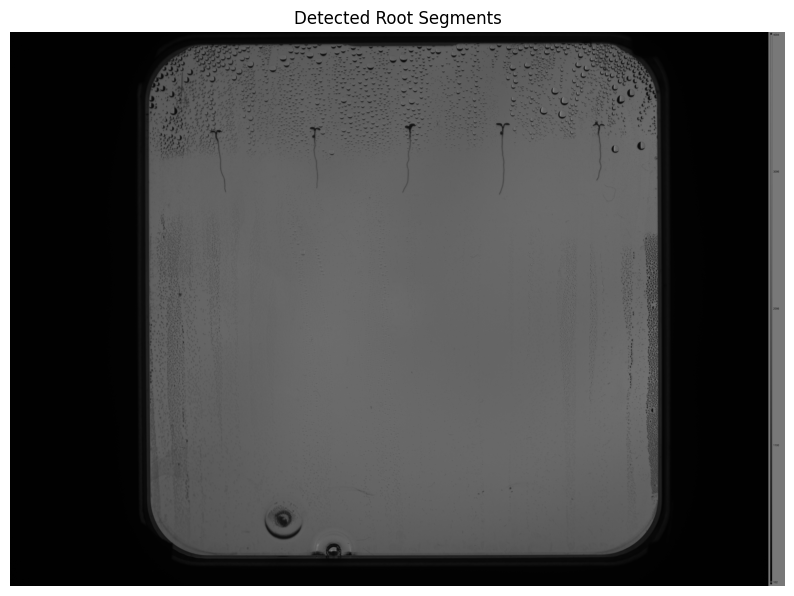

53/53 ━━━━━━━━━━━━━━━━━━━━ 45s 831ms/step
Detected 1 root systems in test_image_16.png


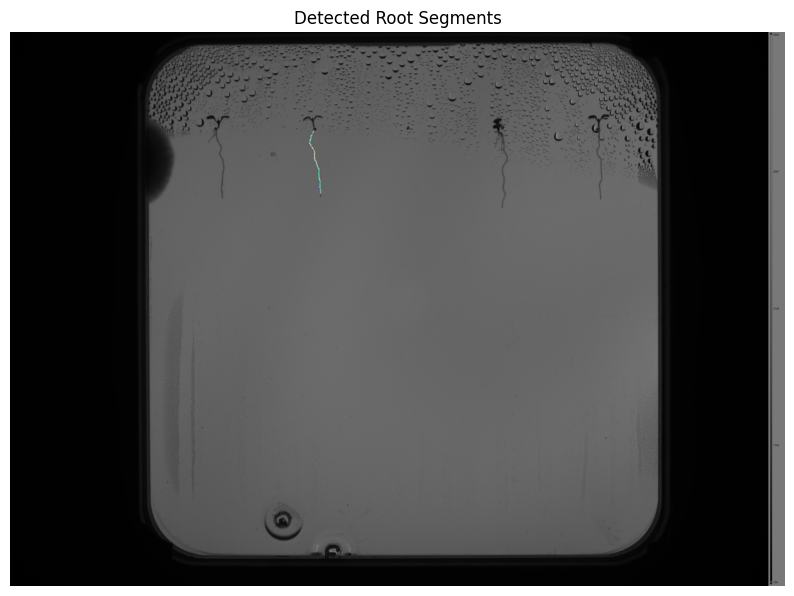

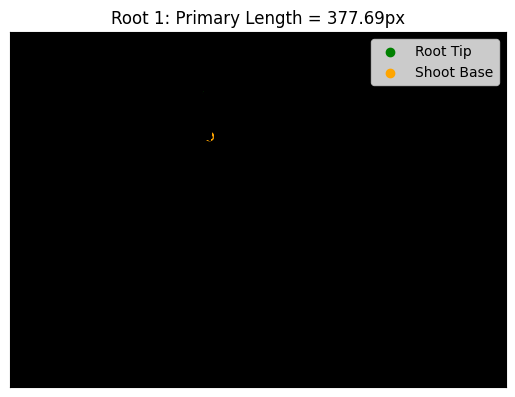

53/53 ━━━━━━━━━━━━━━━━━━━━ 50s 907ms/step
Detected 4 root systems in test_image_17.png


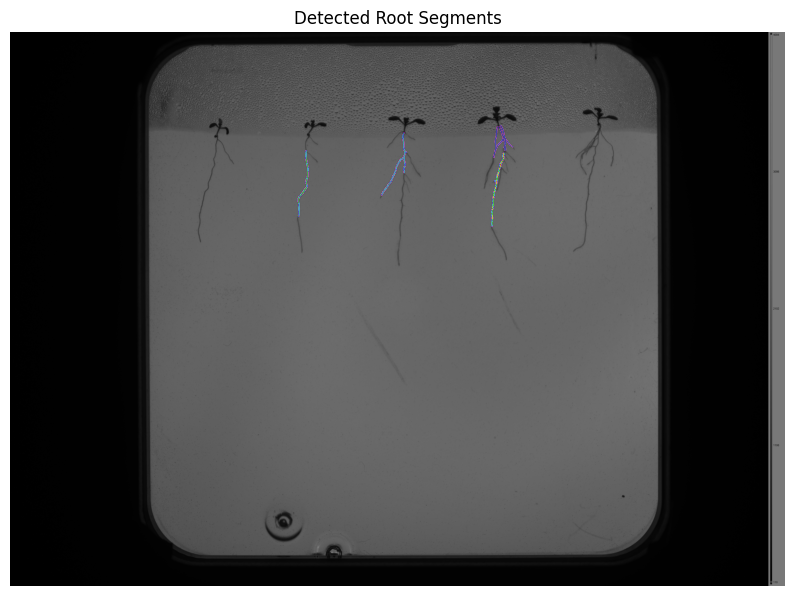

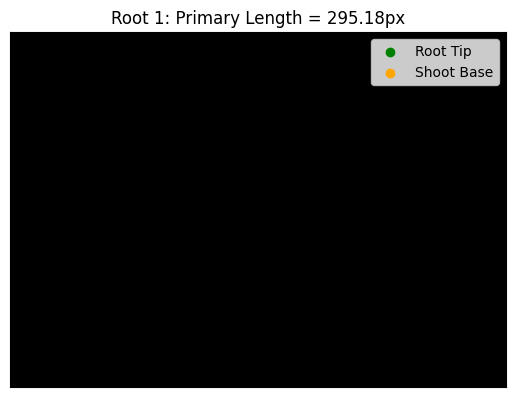

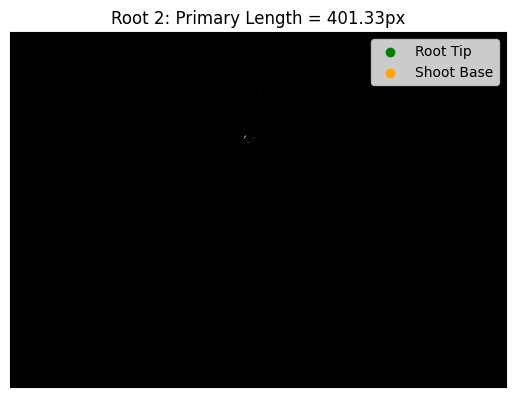

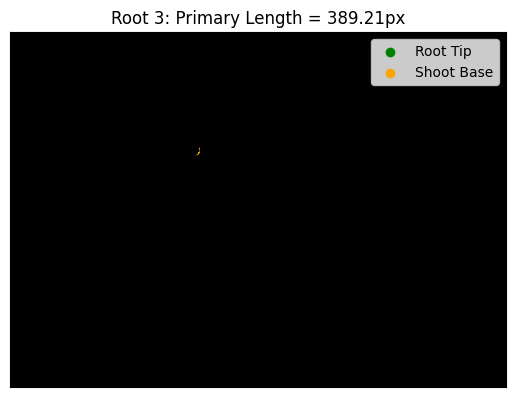

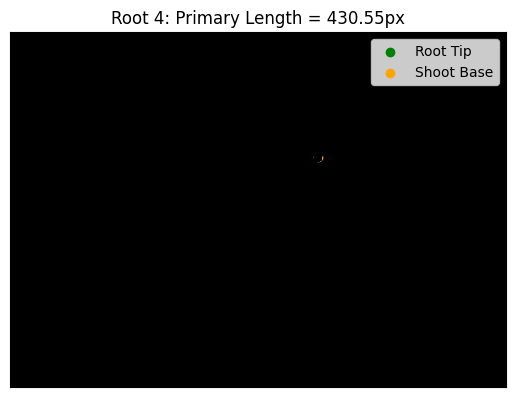

53/53 ━━━━━━━━━━━━━━━━━━━━ 47s 866ms/step
Detected 9 root systems in test_image_18.png


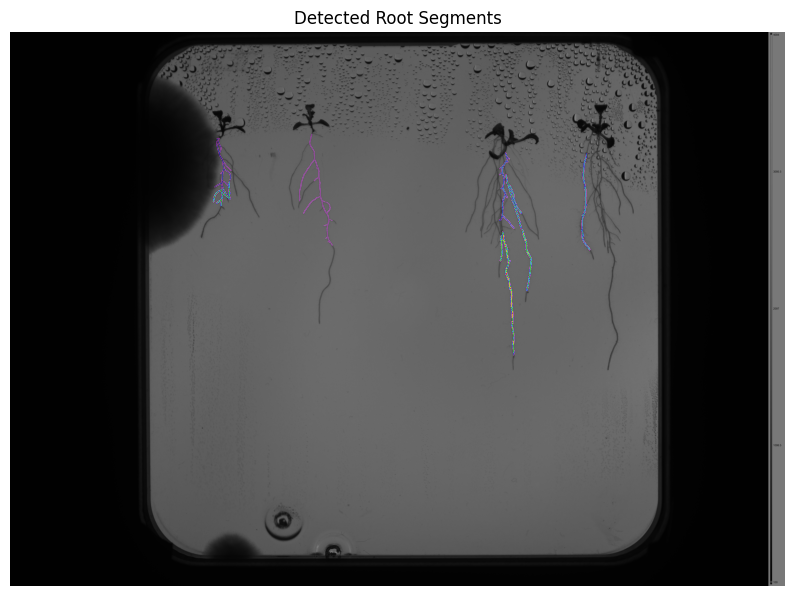

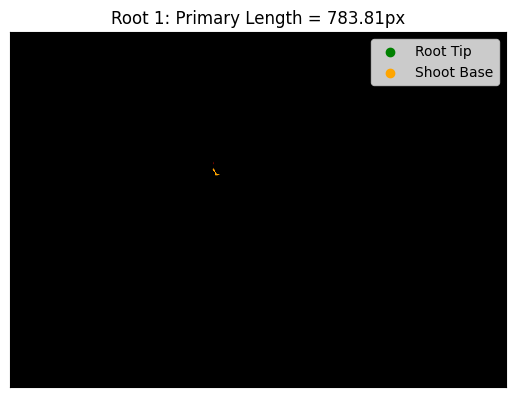

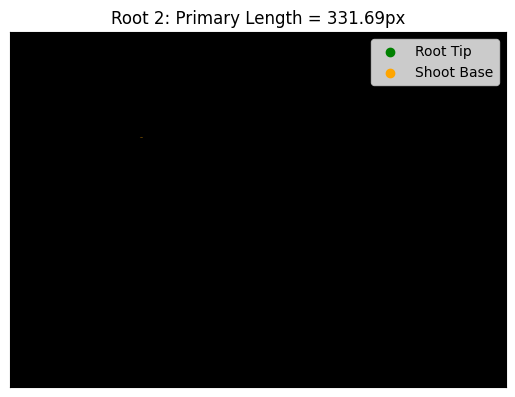

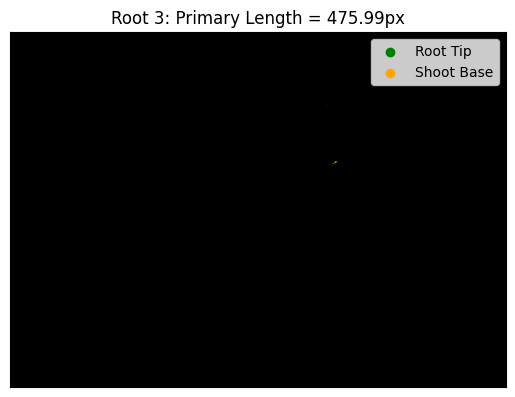

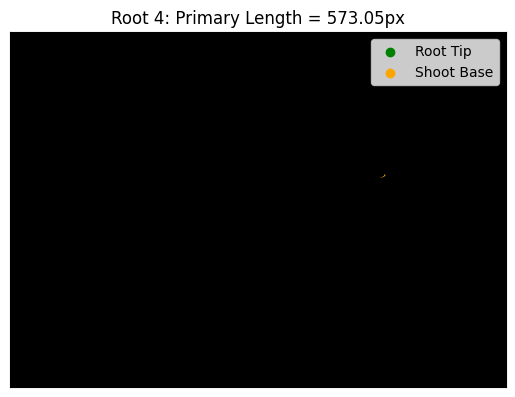

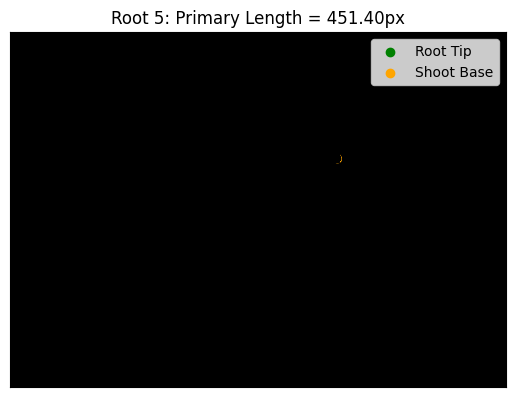

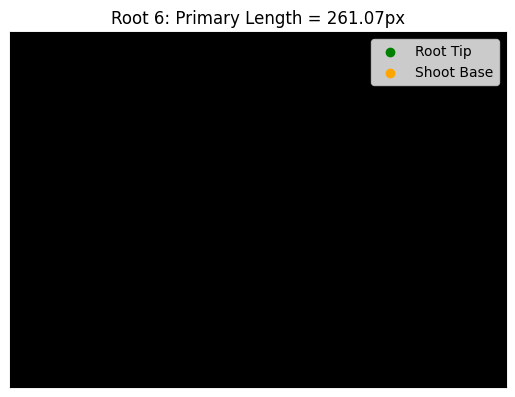

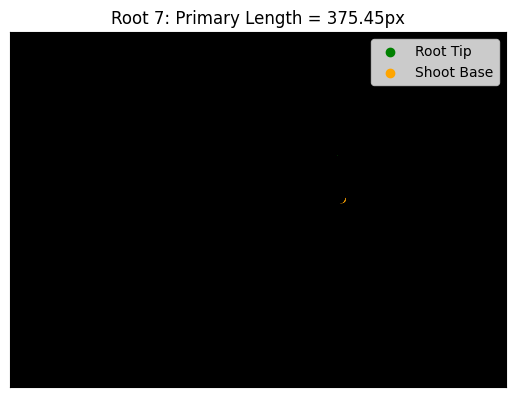

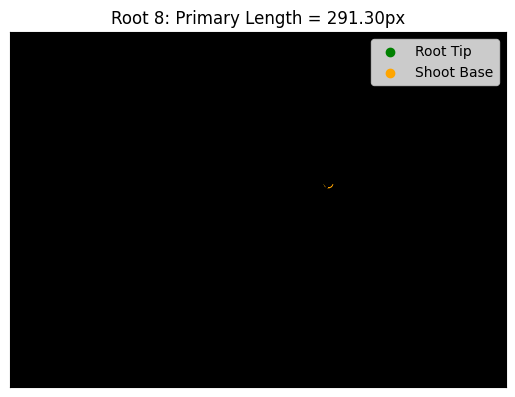

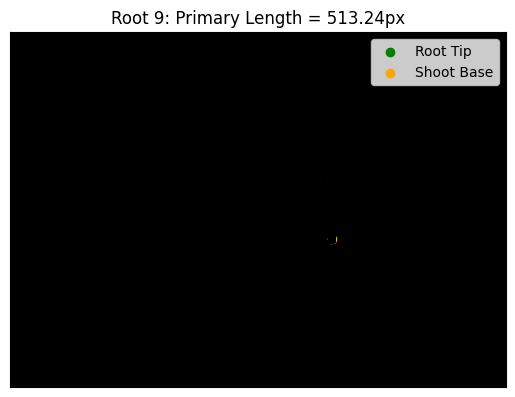

53/53 ━━━━━━━━━━━━━━━━━━━━ 43s 787ms/step
Detected 4 root systems in test_image_2.png


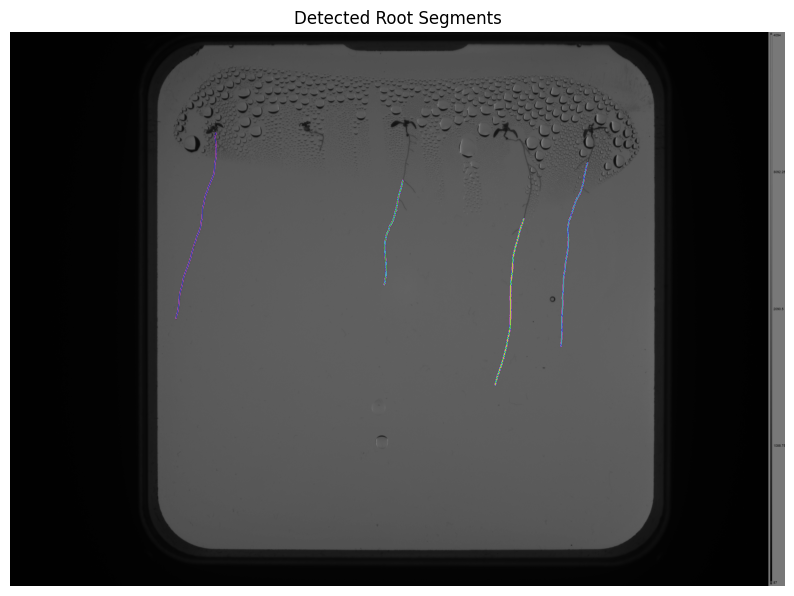

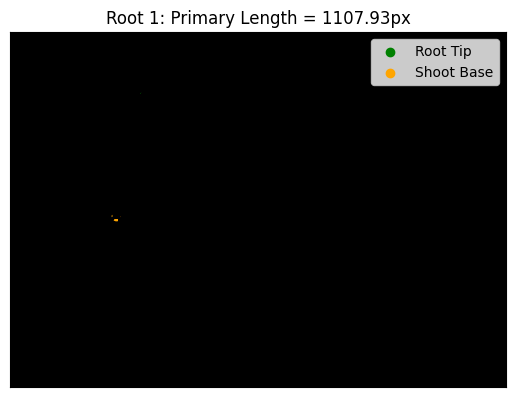

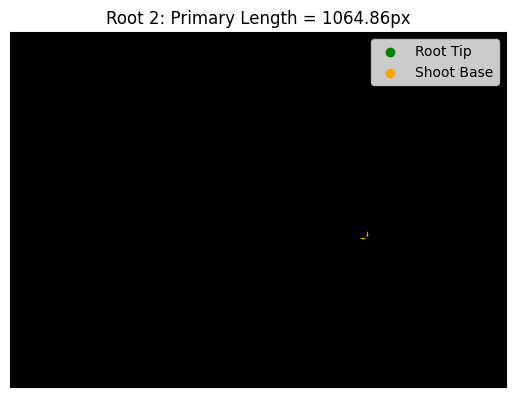

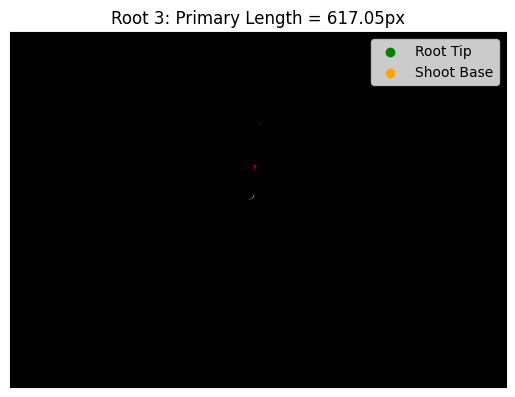

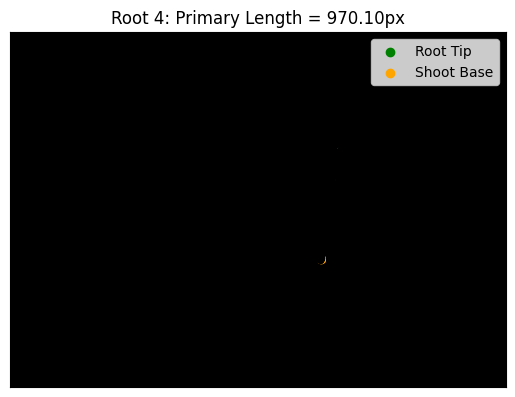

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 102ms/step
Detected 0 root systems in test_image_3.png


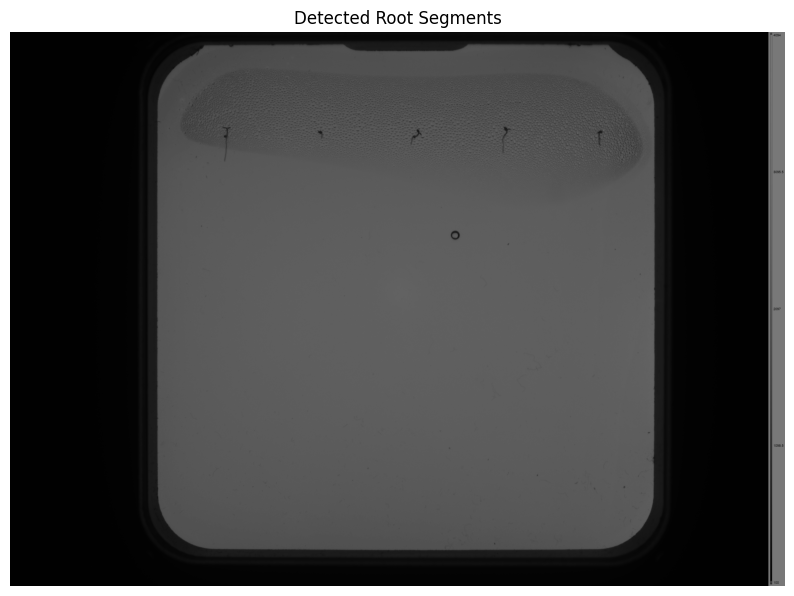

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 102ms/step
Detected 1 root systems in test_image_4.png


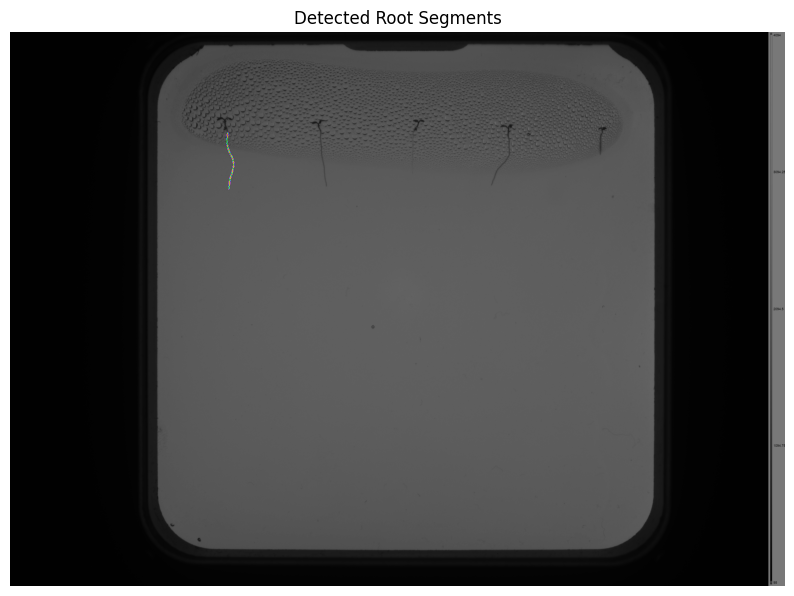

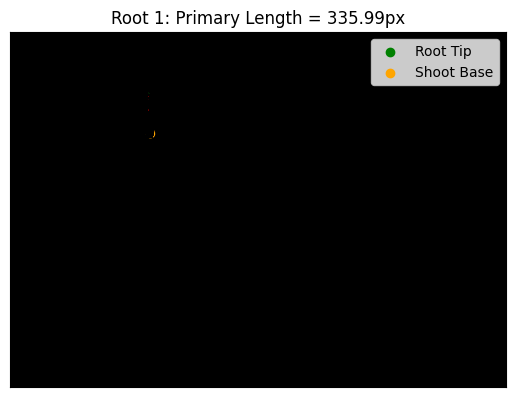

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 104ms/step
Detected 0 root systems in test_image_5.png


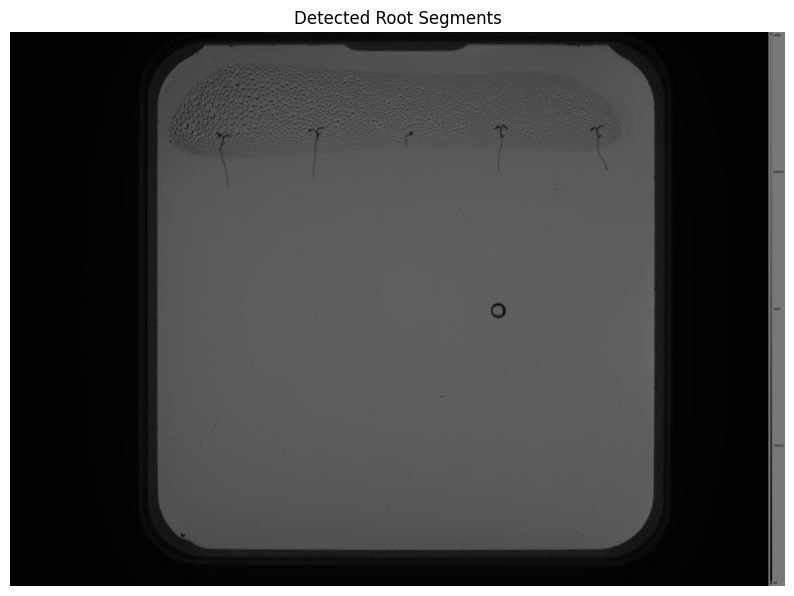

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 102ms/step
Detected 3 root systems in test_image_6.png


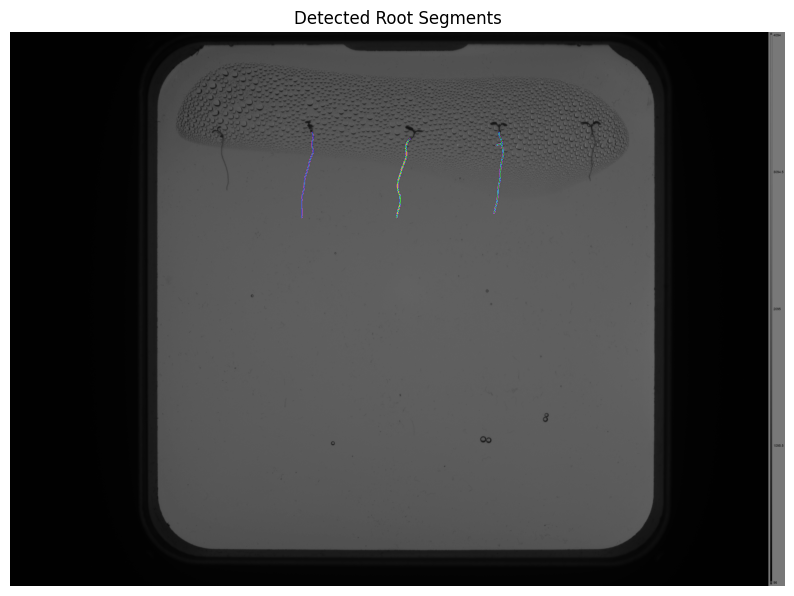

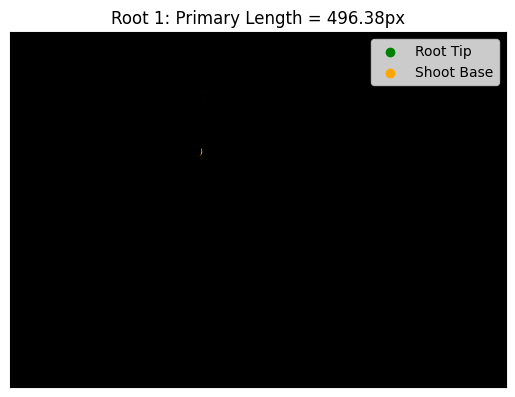

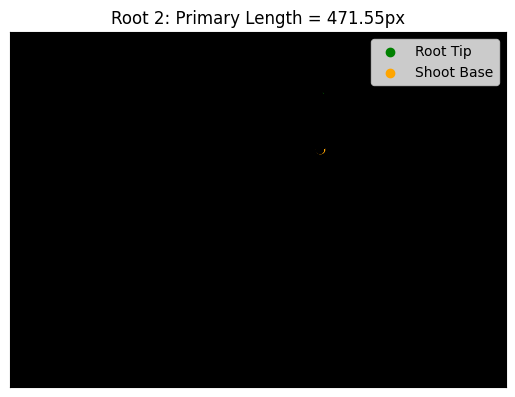

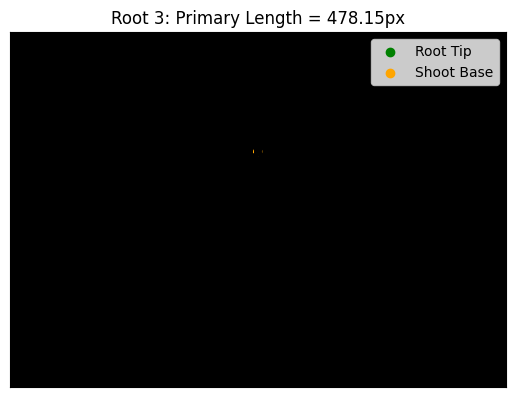

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 103ms/step
Detected 3 root systems in test_image_7.png


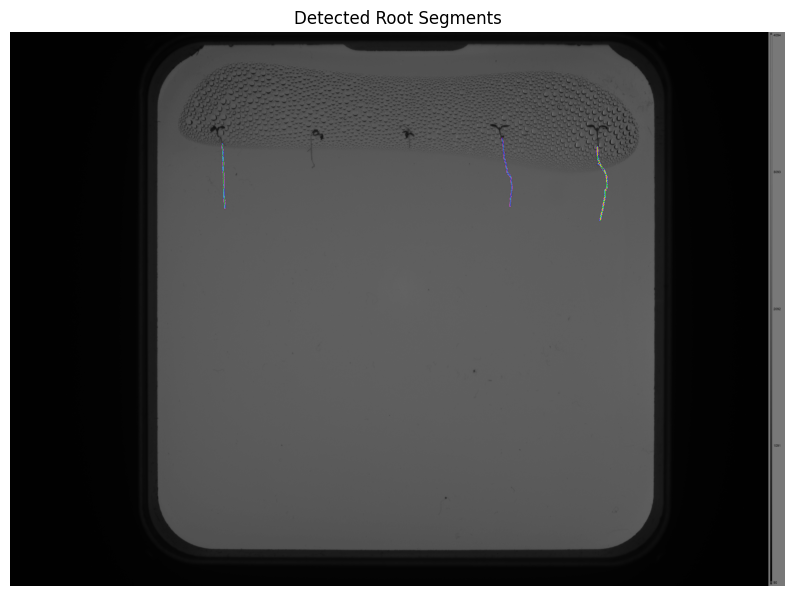

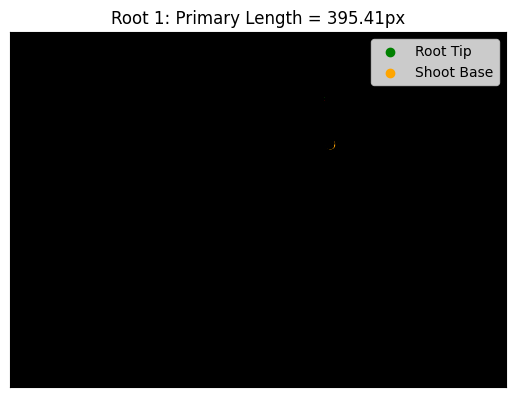

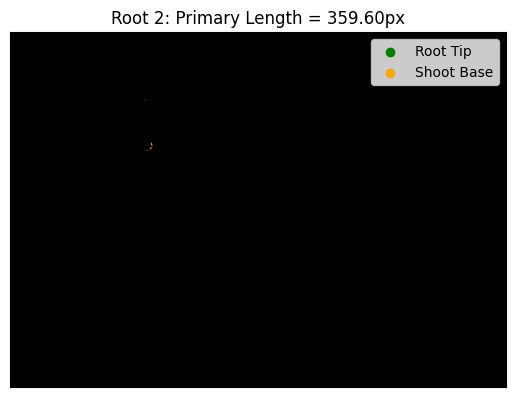

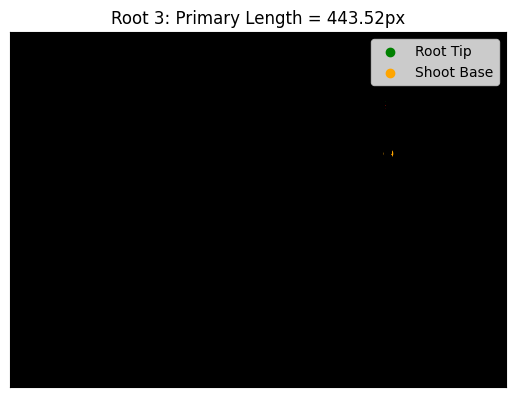

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 101ms/step
Detected 9 root systems in test_image_8.png


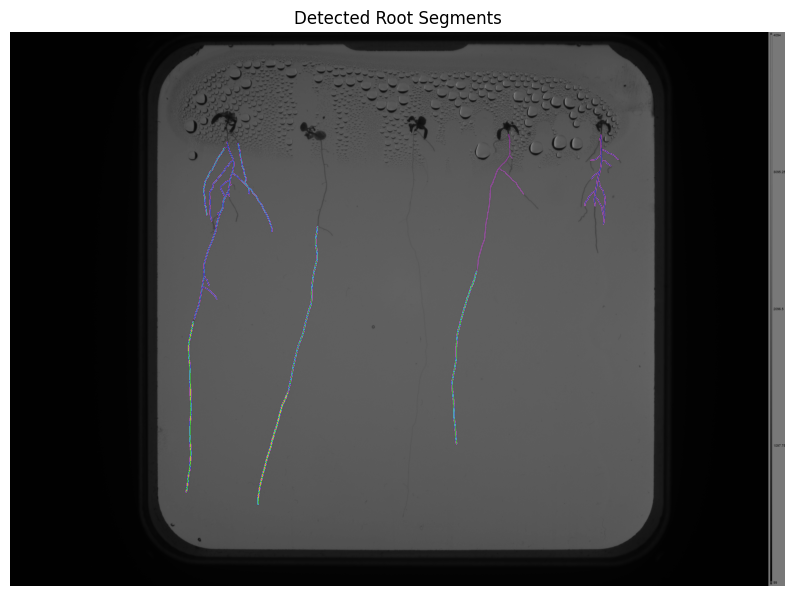

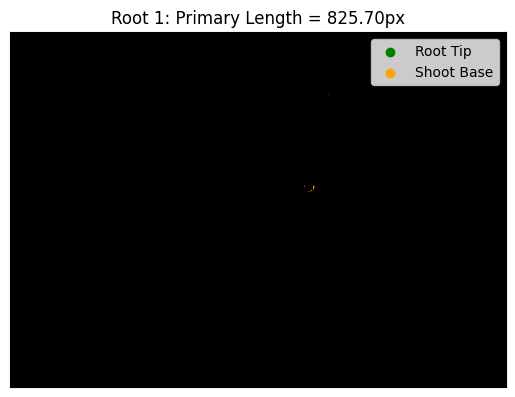

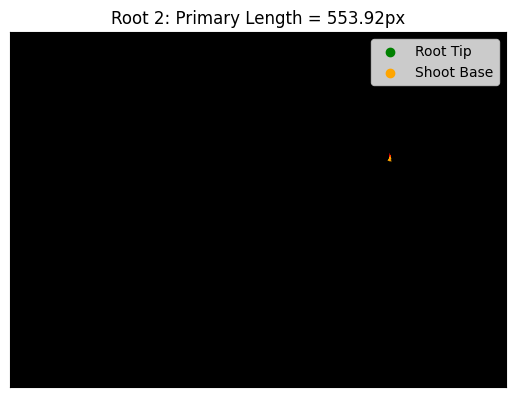

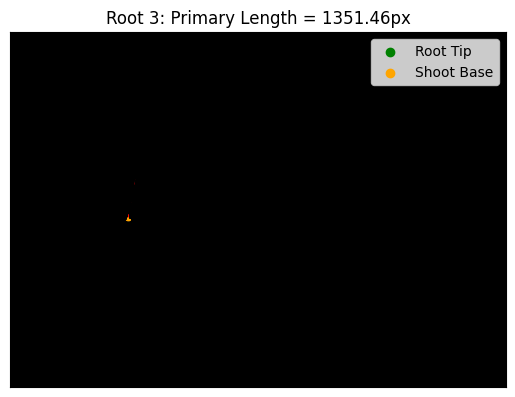

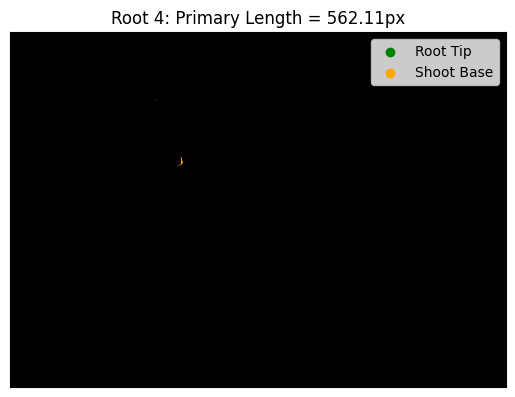

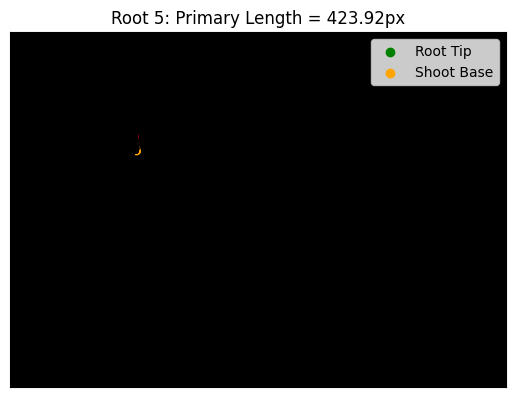

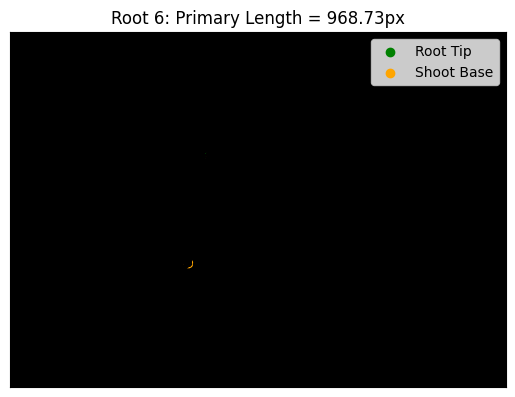

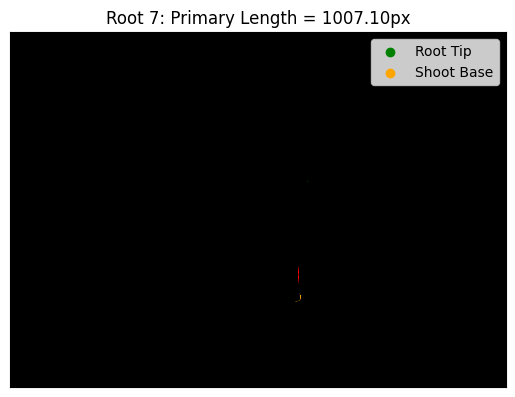

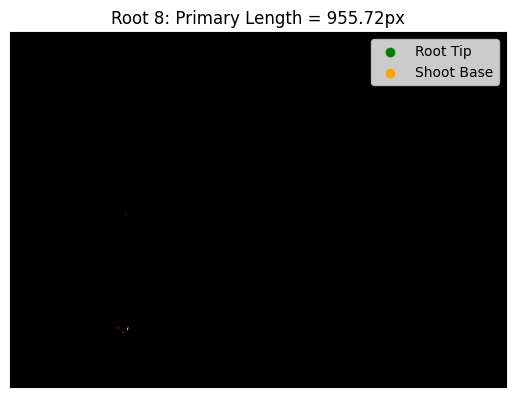

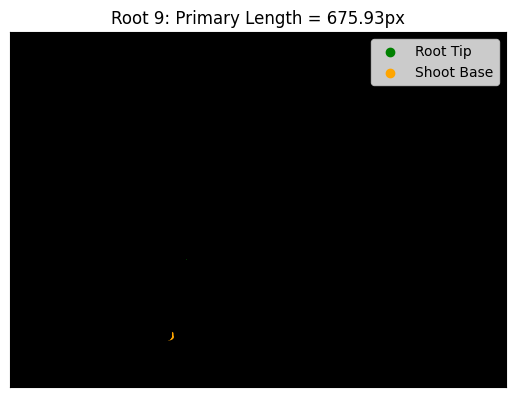

53/53 ━━━━━━━━━━━━━━━━━━━━ 6s 102ms/step
Detected 4 root systems in test_image_9.png


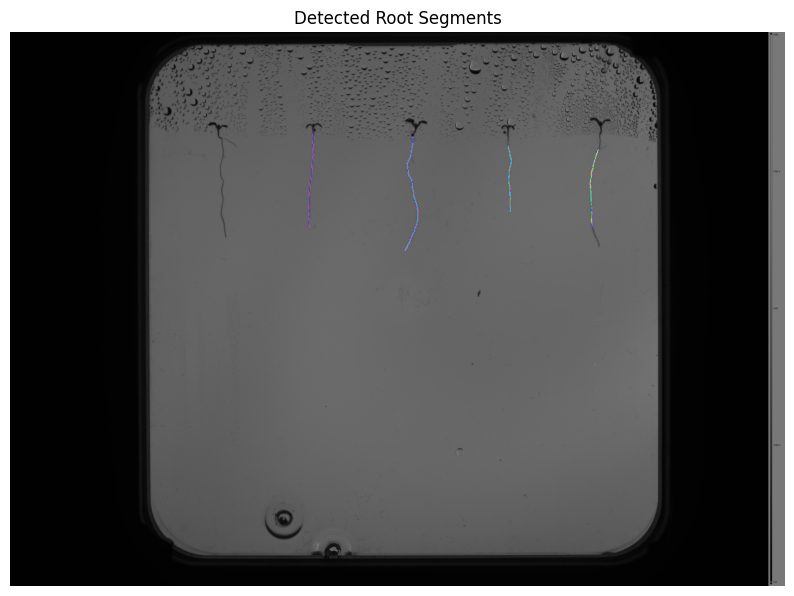

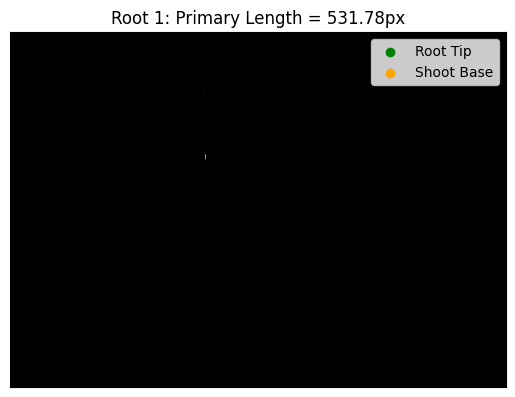

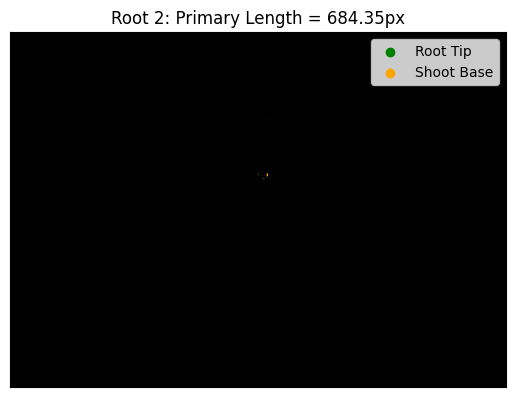

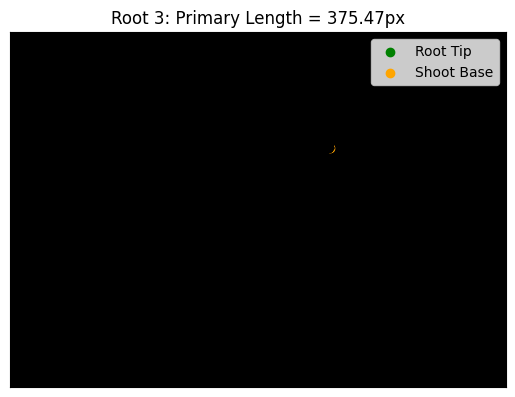

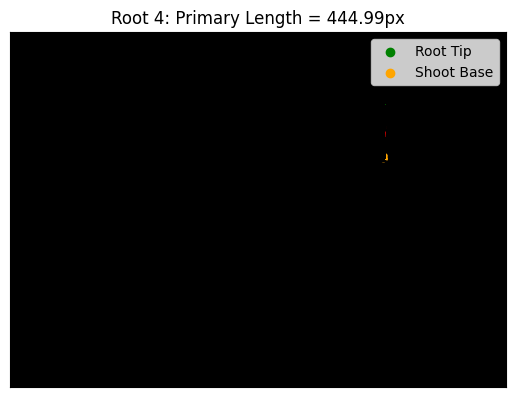

In [1]:
# Root-only RSA Extraction Pipeline (Adapted for Celine)

import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
from patchify import patchify, unpatchify
from skimage.morphology import remove_small_objects, skeletonize
from skimage.measure import label, regionprops
from skan import Skeleton, summarize, draw
from skan.csr import skeleton_to_csgraph
import networkx as nx
from tensorflow.keras.models import load_model

# --- Paths ---
image_folder = "/Users/celinewu/Documents/GitHub/2024-25b-fai2-adsai-CelineWu231265/Kaggle"
model_path = "/Users/celinewu/Documents/GitHub/2024-25b-fai2-adsai-CelineWu231265/datalab_tasks/task5/celine_231265_unet_model_256px.h5"

# --- Parameters ---
patch_size = 256
step_size = 64
threshold = 0.2  # Threshold for binarizing root predictions

# --- Load Model ---
model = load_model(model_path, compile=False)

# --- Helper Functions ---
def padder(image, patch_size):
    h, w = image.shape[:2]
    height_padding = ((h // patch_size) + 1) * patch_size - h
    width_padding = ((w // patch_size) + 1) * patch_size - w
    top_padding = height_padding // 2
    bottom_padding = height_padding - top_padding
    left_padding = width_padding // 2
    right_padding = width_padding - left_padding
    padded_image = cv2.copyMakeBorder(image, top_padding, bottom_padding, left_padding, right_padding, cv2.BORDER_CONSTANT, value=0)
    return padded_image, (top_padding, bottom_padding, left_padding, right_padding)

def unpad(image, padding):
    top_padding, bottom_padding, left_padding, right_padding = padding
    return image[top_padding:image.shape[0] - bottom_padding, left_padding:image.shape[1] - right_padding]

def crop_image(im):
    gray = cv2.GaussianBlur(im, (3, 3), 0)
    _, binary = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)
        roi = im[y:y+h, x:x+w]
        return roi, (x, y, w, h)
    return im, (0, 0, im.shape[1], im.shape[0])

def uncrop(image, roi, crop_coordinates):
    x, y, w, h = crop_coordinates
    output = np.zeros_like(image, dtype=np.float32)
    output[y:y+h, x:x+w] += roi
    return output

# --- Load Images ---
image_files = sorted(glob.glob(os.path.join(image_folder, '*')))

# --- Process Each Image ---
for image_path in image_files:
    image = cv2.imread(image_path, 0)
    petri_dish, coordinates = crop_image(image)
    padded_image, padding = padder(petri_dish, patch_size)
    patches = patchify(padded_image, (patch_size, patch_size), step=step_size)
    i, j = patches.shape[:2]
    patches = patches.reshape(-1, patch_size, patch_size)
    patches_rgb = np.stack([patches]*3, axis=-1) if patches.ndim == 3 else patches[..., np.newaxis].repeat(3, axis=-1)

    preds = model.predict(patches_rgb / 255.0)
    root_preds = np.array([cv2.resize(p[..., 0], (patch_size, patch_size)) for p in preds])
    root_preds = root_preds.reshape(i, j, patch_size, patch_size)
    full_mask = unpatchify(root_preds, padded_image.shape)
    full_mask = unpad(full_mask, padding)
    full_mask = uncrop(image, full_mask, coordinates)
    binary_mask = (full_mask > threshold).astype(np.uint8)

    # --- Clean and Label ---
    cleaned = remove_small_objects(binary_mask > 0, min_size=1500)
    labeled = label(cleaned)
    print(f"Detected {labeled.max()} root systems in {os.path.basename(image_path)}")

    # --- Visualize ---
    plt.figure(figsize=(10, 8))
    plt.imshow(image, cmap='gray')
    plt.imshow(labeled, cmap='nipy_spectral', alpha=0.5)
    plt.title("Detected Root Segments")
    plt.axis('off')
    plt.show()

    # --- Analyze Each Root ---
    regions = regionprops(labeled)
    for idx, region in enumerate(regions):
        root_mask = labeled == region.label
        skel = skeletonize(root_mask)
        g0, coords = skeleton_to_csgraph(skel)
        skeleton_obj = Skeleton(skel)
        branches = summarize(skeleton_obj)
        G = nx.from_pandas_edgelist(branches, 'node-id-src', 'node-id-dst', edge_attr='branch-distance')
        coords = np.transpose(coords)

        endpoints = [n for n in G.nodes if G.degree[n] == 1]
        if len(endpoints) < 2:
            continue

        # Choose the longest path between endpoints
        max_path = []
        max_dist = 0
        for i in range(len(endpoints)):
            for j in range(i+1, len(endpoints)):
                try:
                    path = nx.shortest_path(G, endpoints[i], endpoints[j], weight='branch-distance')
                    dist = nx.shortest_path_length(G, endpoints[i], endpoints[j], weight='branch-distance')
                    if dist > max_dist:
                        max_path = path
                        max_dist = dist
                except:
                    continue

        if max_path:
            fig, ax = plt.subplots()
            draw.overlay_skeleton_networkx(g0, coords, image=skel, axis=ax, node_size=0)
            tip, base = coords[max_path[0]], coords[max_path[-1]]
            ax.scatter(tip[1], tip[0], c='green', label='Root Tip')
            ax.scatter(base[1], base[0], c='orange', label='Shoot Base')
            for i in range(len(max_path)-1):
                y1, x1 = coords[max_path[i]]
                y2, x2 = coords[max_path[i+1]]
                ax.plot([x1, x2], [y1, y2], color='red', lw=1.5)
            ax.set_title(f"Root {idx+1}: Primary Length = {max_dist:.2f}px")
            ax.legend()
            plt.show()

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 120ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 97ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step


/var/folders/kz/slhyr0gd4qj4nrryyswvqv4c0000gn/T/ipykernel_29082/362893106.py:91: VisibleDeprecationWarning: separator in column name will change to _ in version 0.13; to silence this warning, use `separator='-'` to maintain current behavior and use `separator='_'` to switch to the new default behavior.
  branch_data = summarize(skel)


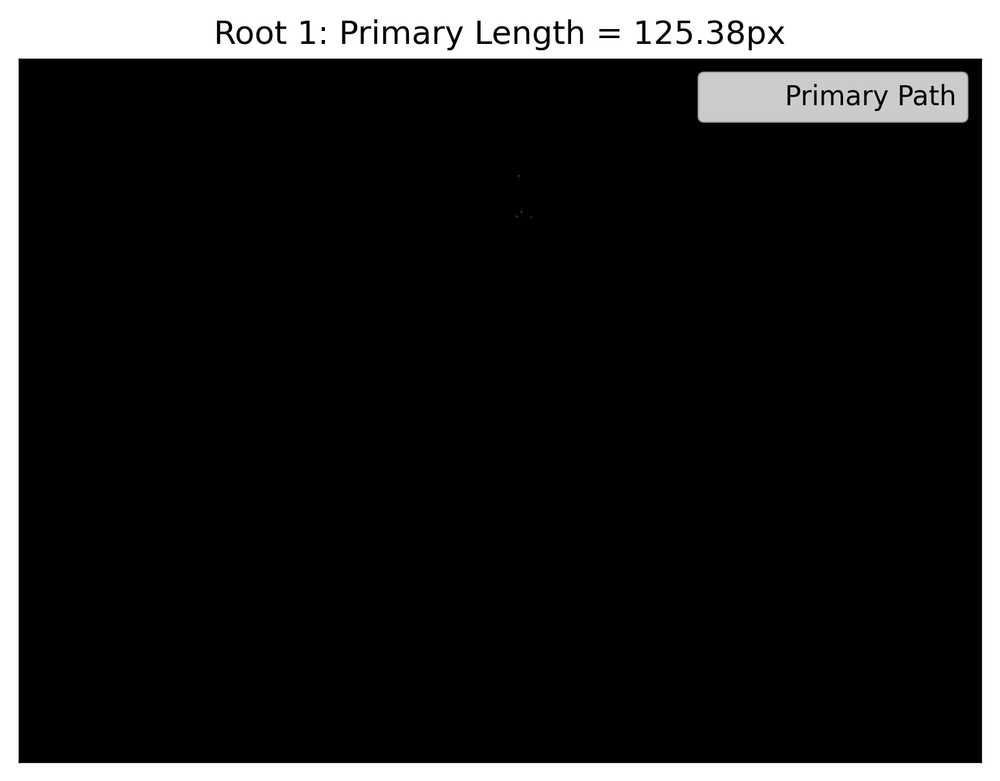

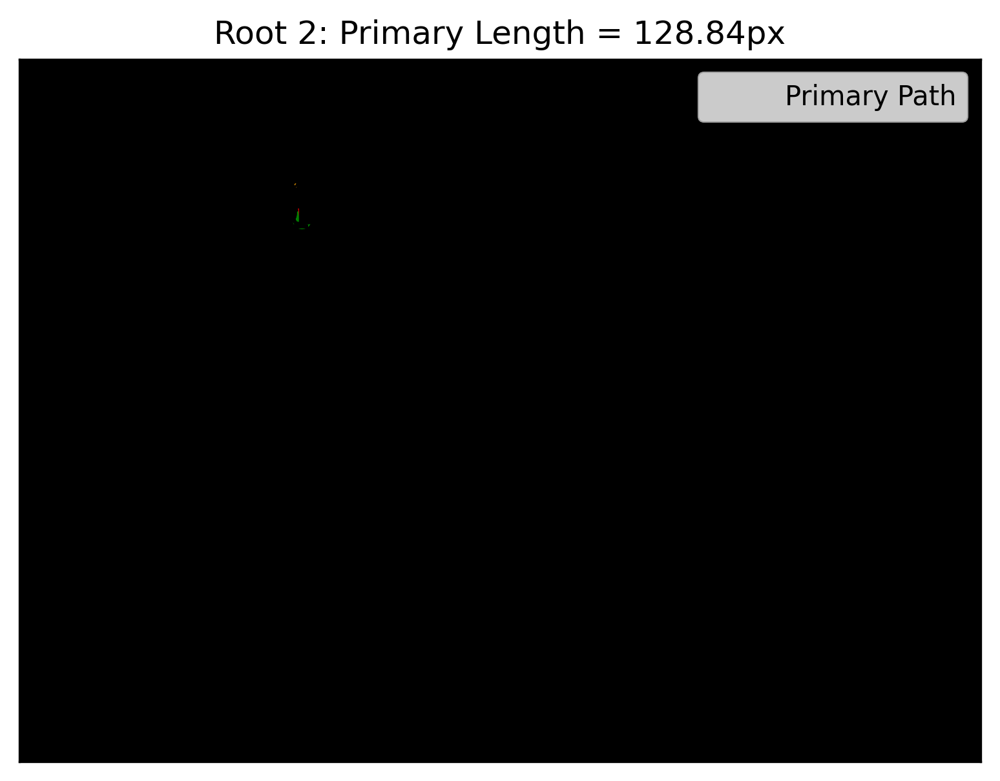

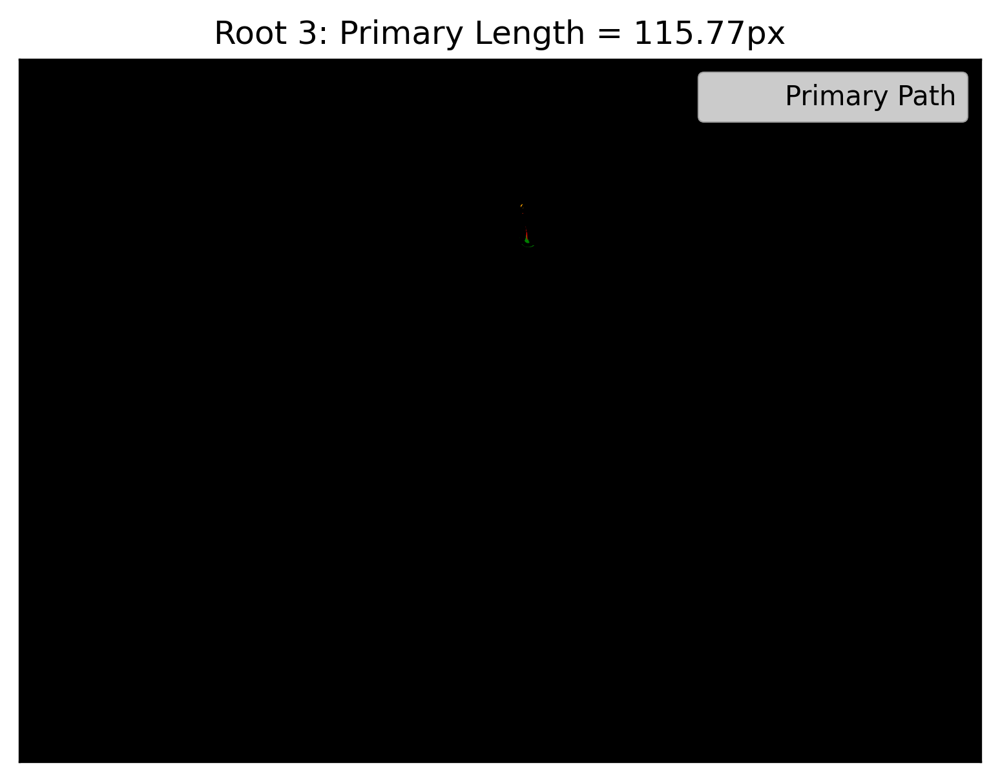

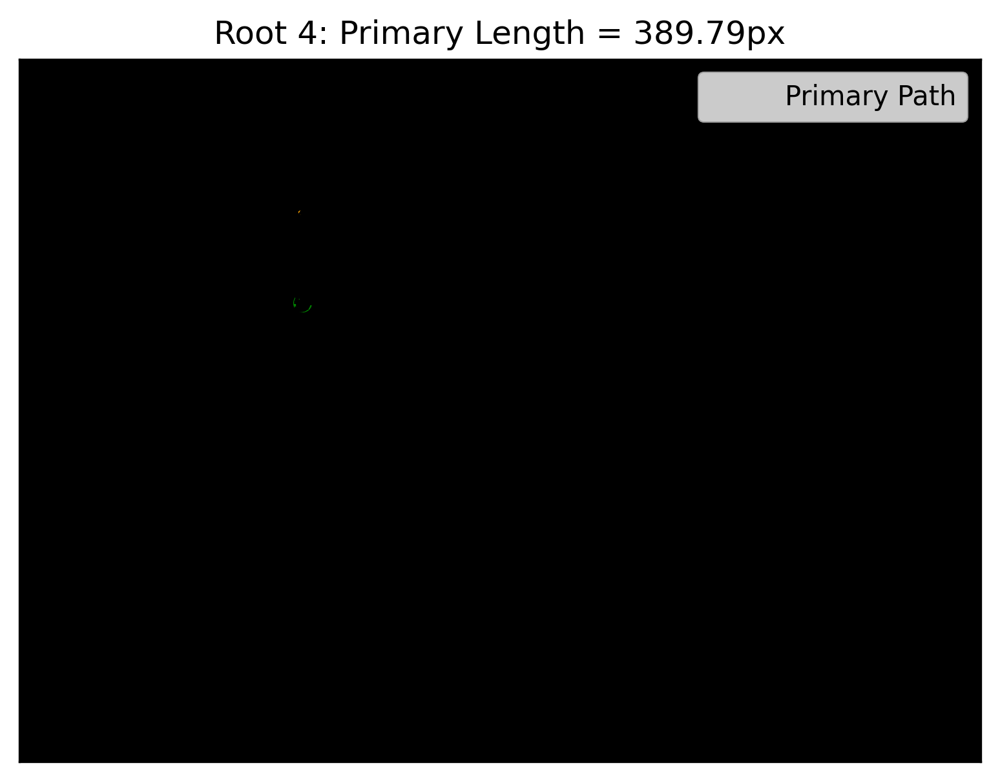

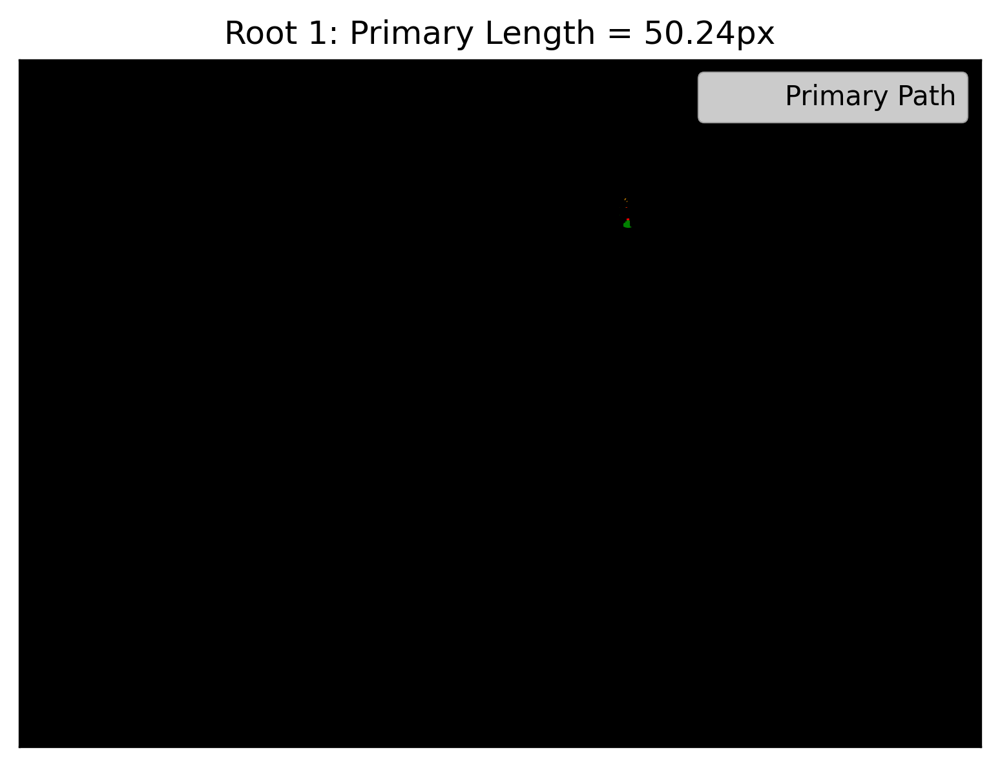

...

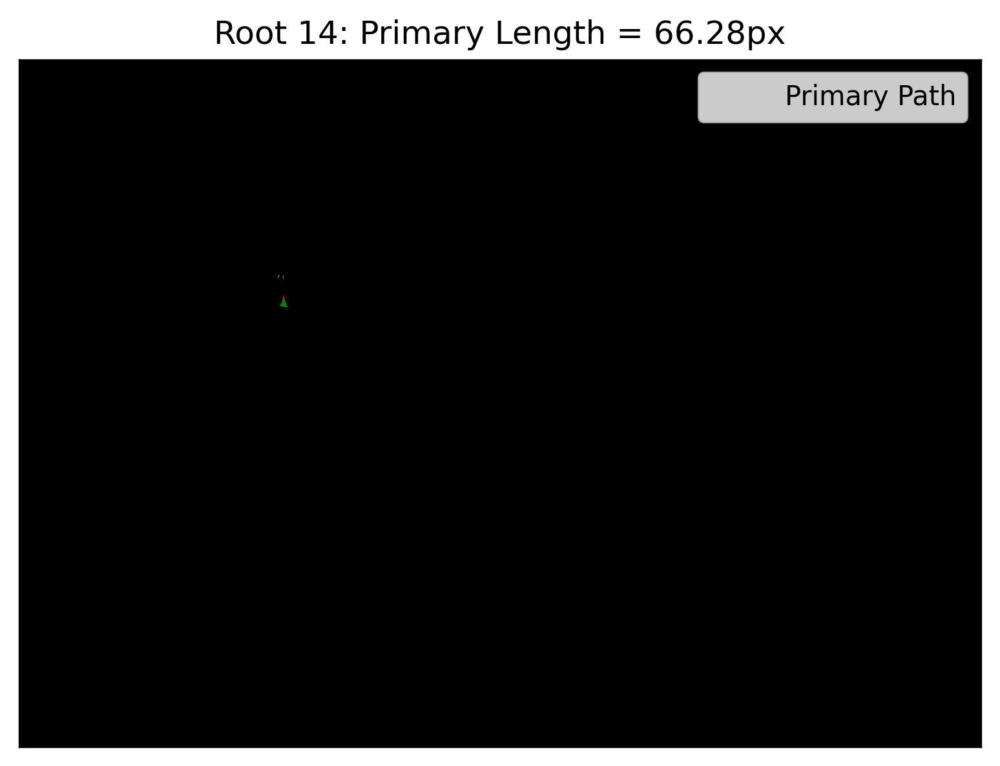

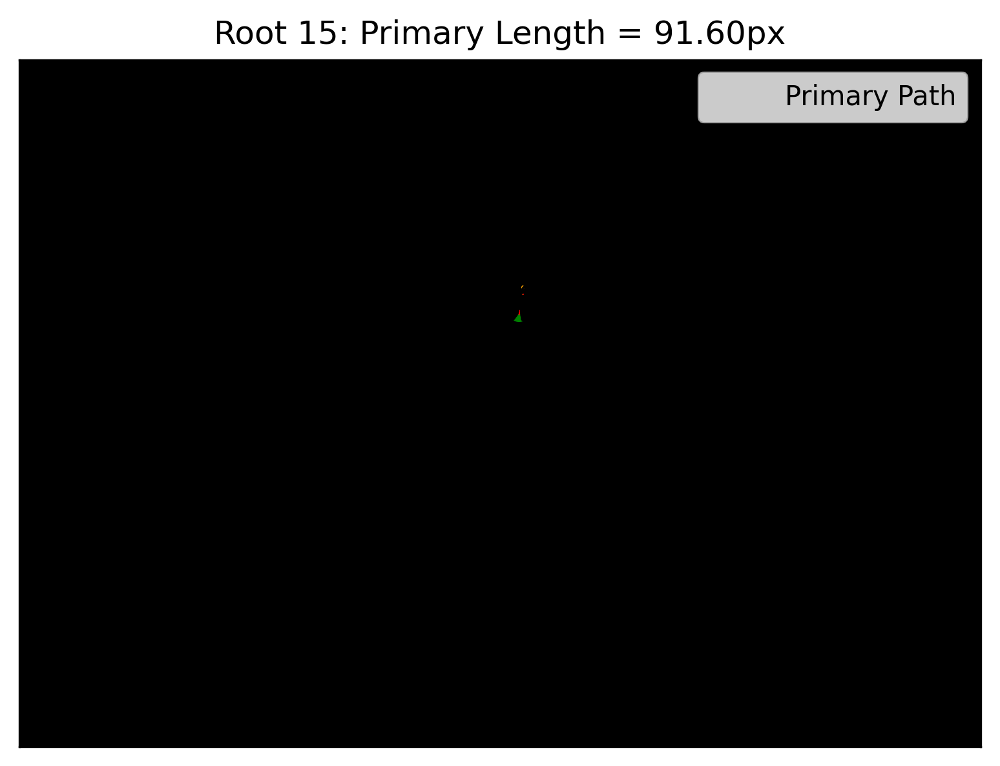

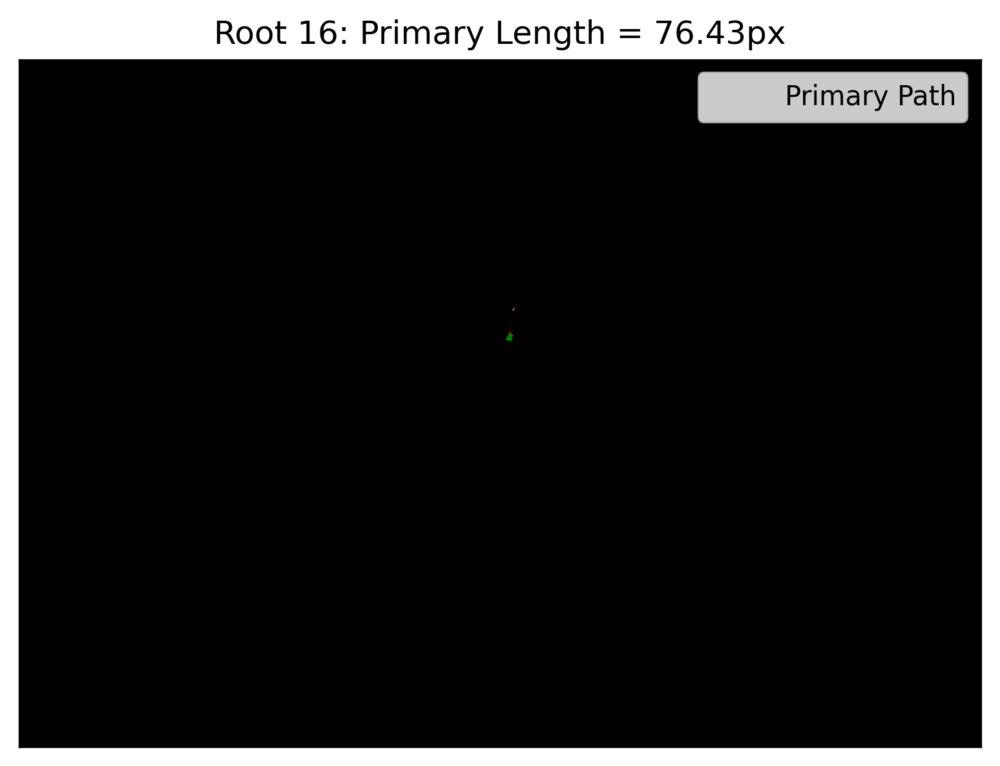

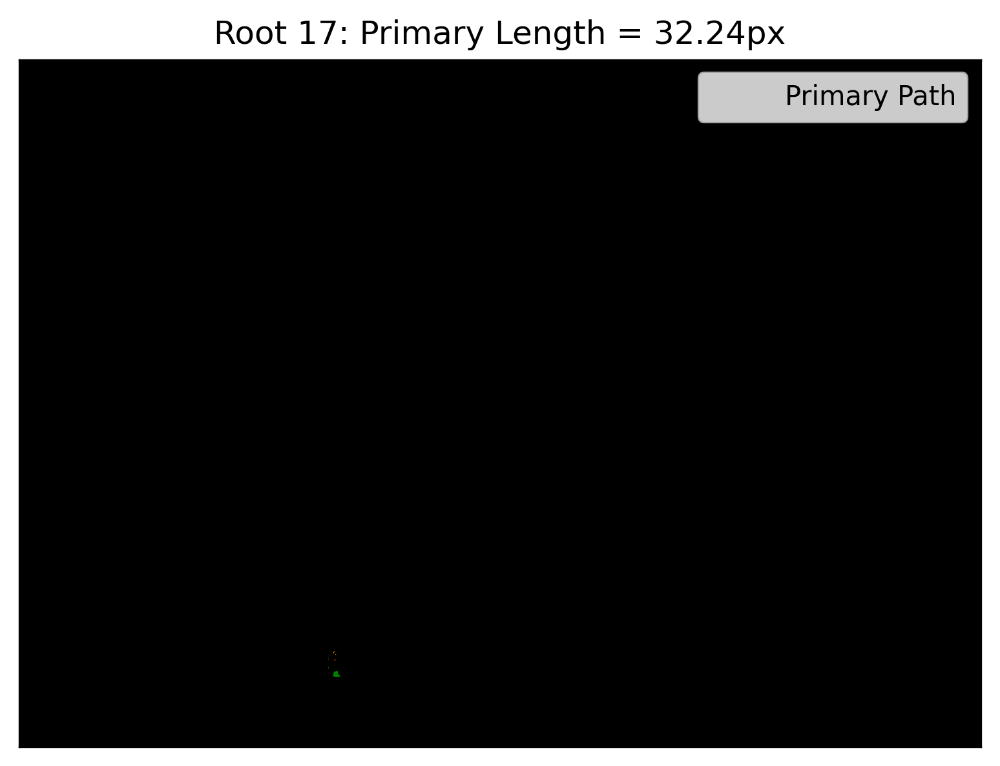

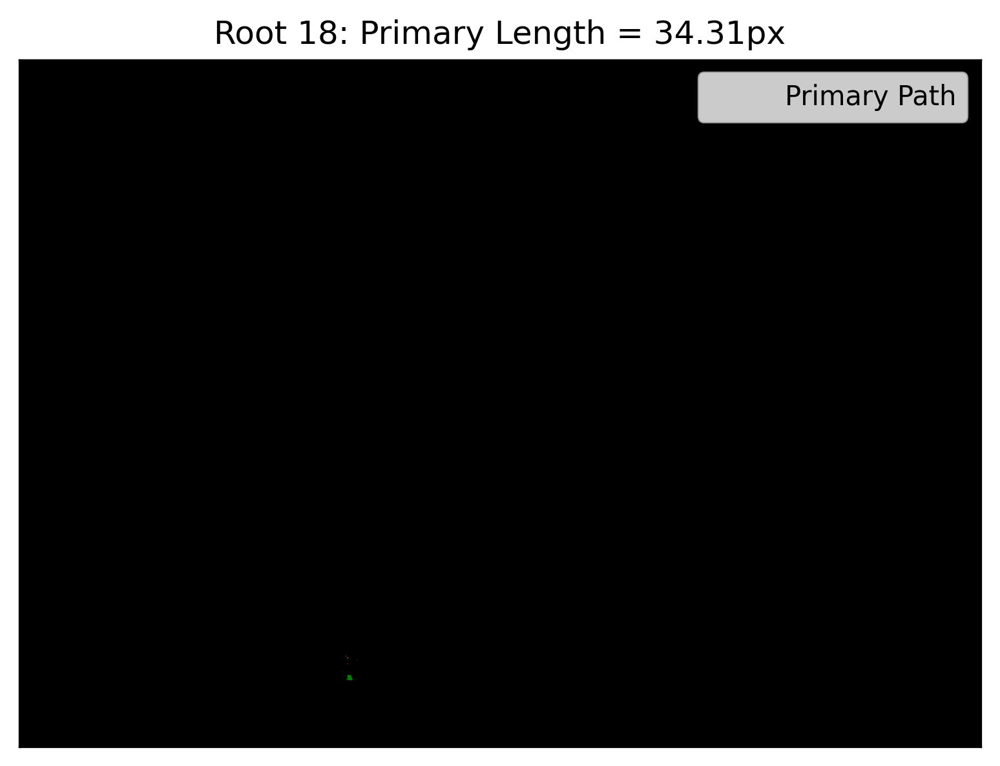

Root length CSV saved to: /Users/celinewu/Documents/GitHub/2024-25b-fai2-adsai-CelineWu231265/root_lengths.csv


In [4]:
# Root-only RSA Extraction Pipeline (Single Model Version)

import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
from patchify import patchify, unpatchify
from tensorflow.keras.models import load_model
import tensorflow.keras.backend as K
from skimage.morphology import remove_small_objects, skeletonize
from skimage.measure import label, regionprops
from skan import Skeleton, summarize
from skan.csr import skeleton_to_csgraph
from skan import draw
import networkx as nx
import csv

# Custom F1 metric

def f1(y_true, y_pred):
    y_pred = K.round(y_pred)
    tp = K.sum(K.cast(y_true * y_pred, 'float32'))
    fp = K.sum(K.cast(y_pred * (1 - y_true), 'float32'))
    fn = K.sum(K.cast((1 - y_pred) * y_true, 'float32'))
    precision = tp / (tp + fp + K.epsilon())
    recall = tp / (tp + fn + K.epsilon())
    return 2 * (precision * recall) / (precision + recall + K.epsilon())

# Load model (single root model only)
model_path = "/Users/celinewu/Documents/GitHub/2024-25b-fai2-adsai-CelineWu231265/datalab_tasks/task5/celine_231265_unet_model_256px.h5"
model = load_model(model_path, compile=False, custom_objects={'f1': f1})

# Dataset path
image_folder = "/Users/celinewu/Documents/GitHub/2024-25b-fai2-adsai-CelineWu231265/Kaggle"
image_files = sorted(glob.glob(f"{image_folder}/*.png"))

# Patch parameters
patch_size = 256
step_size = 256

# Storage
processed_images = []
root_masks = []

# Prediction pipeline
for image_path in image_files:
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Padding
    h, w = gray.shape
    pad_h = (patch_size - h % patch_size) % patch_size
    pad_w = (patch_size - w % patch_size) % patch_size
    gray_padded = cv2.copyMakeBorder(gray, 0, pad_h, 0, pad_w, cv2.BORDER_CONSTANT, value=0)

    # Patchify
    patches = patchify(gray_padded, (patch_size, patch_size), step=step_size)
    i, j = patches.shape[:2]
    patches = patches.reshape(-1, patch_size, patch_size)
    patches_rgb = np.stack([patches] * 3, axis=-1).reshape(-1, patch_size, patch_size, 3)

    # Predict
    preds = model.predict(patches_rgb / 255.0)
    preds = preds.reshape(i, j, patch_size, patch_size)
    mask = unpatchify(preds, gray_padded.shape)
    mask = mask[:h, :w]  # Unpad
    root_masks.append(mask)
    processed_images.append(gray)

# Thresholding and cleaning
binary_masks = [(mask > 0.5).astype(np.uint8) for mask in root_masks]
binary_masks = [remove_small_objects(label(mask), min_size=100) for mask in binary_masks]

# CSV Output
csv_path = "/Users/celinewu/Documents/GitHub/2024-25b-fai2-adsai-CelineWu231265/root_lengths.csv"
with open(csv_path, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Image", "Root Index", "Length (px)"])

    # Primary Root Length Measurement
    for i, mask in enumerate(binary_masks):
        labeled_mask = label(mask)
        props = regionprops(labeled_mask)

        for j, region in enumerate(props):
            submask = labeled_mask == region.label
            skeleton = skeletonize(submask)
            graph, coords = skeleton_to_csgraph(skeleton)
            skel = Skeleton(skeleton)
            branch_data = summarize(skel)
            G = nx.from_pandas_edgelist(branch_data, source='node-id-src', target='node-id-dst', edge_attr='branch-distance')

            degree_1_nodes = [n for n, deg in G.degree() if deg == 1]
            if len(degree_1_nodes) < 2:
                continue

            coords = np.transpose(coords)
            top_node = min(degree_1_nodes, key=lambda x: coords[x][0])
            bottom_node = max(degree_1_nodes, key=lambda x: coords[x][0])

            try:
                path = nx.shortest_path(G, source=top_node, target=bottom_node, weight='branch-distance')
                total_distance = nx.shortest_path_length(G, source=top_node, target=bottom_node, weight='branch-distance')

                # Write to CSV
                writer.writerow([os.path.basename(image_files[i]), j + 1, round(total_distance, 2)])

                # Visualize primary root
                fig, ax = plt.subplots(dpi=300)
                draw.overlay_skeleton_networkx(graph, coords, image=skeleton, axis=ax, node_size=0)
                for k in range(len(path) - 1):
                    y0, x0 = coords[path[k]]
                    y1, x1 = coords[path[k + 1]]
                    ax.plot([x0, x1], [y0, y1], color='red')
                ax.set_title(f"Root {j+1}: Primary Length = {total_distance:.2f}px")
                ax.legend(["Primary Path"], loc='upper right')
                ax.scatter(coords[top_node][1], coords[top_node][0], c='orange', label='Top')
                ax.scatter(coords[bottom_node][1], coords[bottom_node][0], c='green', label='Bottom')
                plt.show()

            except nx.NetworkXNoPath:
                continue

print(f"Root length CSV saved to: {csv_path}")
